In [1]:
import pandas as pd
import gc
import re
import numpy as np
import torch
import datasets
from ray import tune
from ray import train
from ray.train import Checkpoint, get_checkpoint
from ray.tune.schedulers import ASHAScheduler
import ray.cloudpickle as pickle
# from datasets import Dataset, ClassLabel
import transformers
import warnings 
warnings.filterwarnings("ignore")
from tqdm import tqdm
tqdm.pandas()
from pathlib import Path
import librosa
import librosa.display
import IPython.display as ipd
from IPython.display import Audio
import torchaudio
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
from os.path import isfile, isdir, dirname
from os import mkdir
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
from pydub import AudioSegment
from torch.utils.data import Dataset
from sklearn.model_selection import train_test_split
from torch.cuda.amp import autocast, GradScaler
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

In [2]:
RATE_HZ = 16000 # resampling rate in Hz
MAX_LENGTH = 480000 # maximum audio interval length to consider (= RATE_HZ * SECONDS)
labels = ['cuphead', 'minecraft', 'undertale', 'doom', 'kirby', 'celeste', 'rocket league', 'stardew valley']
label2id, id2label = dict(), dict()
for i, label in enumerate(labels):
    label2id[label] = i
    id2label[i] = label

print(id2label, '\n\n', label2id)

{0: 'cuphead', 1: 'minecraft', 2: 'undertale', 3: 'doom', 4: 'kirby', 5: 'celeste', 6: 'rocket league', 7: 'stardew valley'} 

 {'cuphead': 0, 'minecraft': 1, 'undertale': 2, 'doom': 3, 'kirby': 4, 'celeste': 5, 'rocket league': 6, 'stardew valley': 7}


In [3]:
def load_data():
    file_list = []
    label_list = []
    for folder in Path(r'./30 sec train').glob('*'):
        for file in Path(folder).glob('*.wav'):
            file_list.append(file)
            label_list.append(label2id[str(folder).split('\\')[1]])
    dd = pd.DataFrame()
    dd['file'] = file_list
    dd['label'] = label_list
    return dd

In [4]:
dataset = load_data()
print("we have:",dataset.shape[0], "songs")
dataset.head()

we have: 938 songs


,file,label
0,"30 sec train\celeste\celestesong_num_0,sample_...",5
1,"30 sec train\celeste\celestesong_num_0,sample_...",5
2,"30 sec train\celeste\celestesong_num_0,sample_...",5
3,"30 sec train\celeste\celestesong_num_0,sample_...",5
4,"30 sec train\celeste\celestesong_num_0,sample_...",5


In [5]:
train_df, test_df = train_test_split(dataset, test_size=0.2, random_state=42)

In [6]:
torchaudio.set_audio_backend("soundfile")
print(torchaudio.list_audio_backends())

['soundfile']


In [8]:
Audio(dataset['file'][229])

In [11]:
def get_transform_audio(file):
    audio,rate = torchaudio.load(str(file).replace('\\','/'))
    if audio.shape[0] > 1:  # If audio is sterio, turn it to mono
        audio = torch.mean(audio, dim=0, keepdim=True)
    transform = torchaudio.transforms.Resample(rate,RATE_HZ)
    audio = transform(audio).squeeze(0).numpy()
    audio = audio[:MAX_LENGTH]
    return audio # truncate to first part of audio to save RAM


In [12]:
class AudioDataset(Dataset):
    def __init__(self, dataframe, feature_extractor, rate_hz):
        self.dataframe = dataframe
        self.feature_extractor = feature_extractor
        self.rate_hz = rate_hz

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        row = self.dataframe.iloc[idx]
        file_path = row["file"]  # Adjust if your column name is different
        label = row["label"]

        # Load and preprocess audio
        audio_input = get_transform_audio(file_path)
        inputs = self.feature_extractor(audio_input, sampling_rate=self.rate_hz, return_tensors="pt")

        return {
            "input_values": inputs["input_values"].squeeze(0),  # Ensure correct shape
            "label": torch.tensor(label, dtype=torch.long),
        }

In [11]:
# from transformers import AutoFeatureExtractor, AutoModelForAudioClassification
# model_str = "dima806/music_genres_classification" 
# feature_extractor = AutoFeatureExtractor.from_pretrained(model_str)
# model = AutoModelForAudioClassification.from_pretrained(model_str)
# # model = AutoModelForAudioClassification.from_pretrained(model_str,num_labels=10)
# model.config.id2label = id2label

In [22]:
# Load model directly
from transformers import AutoFeatureExtractor, AutoModelForAudioClassification

feature_extractor = AutoFeatureExtractor.from_pretrained("artyomboyko/distilhubert-finetuned-gtzan")
model = AutoModelForAudioClassification.from_pretrained("artyomboyko/distilhubert-finetuned-gtzan")
model.config.id2label = id2label

In [14]:
print(f"parameters: {sum(p.numel() for p in model.parameters() if p.requires_grad) / 1e6}M")

parameters: 23.691402M


In [23]:
# model.classifier = nn.Linear(in_features=256,out_features=len(labels))
model.classifier = nn.Sequential(
    nn.Linear(model.classifier.in_features, 128),  
    nn.ReLU(),
    nn.Dropout(0.3),
    nn.Linear(128, 8)  # Output layer for 10 classes
)
model.named_parameters #find the layers we want to work with

<bound method Module.named_parameters of HubertForSequenceClassification(
  (hubert): HubertModel(
    (feature_extractor): HubertFeatureEncoder(
      (conv_layers): ModuleList(
        (0): HubertGroupNormConvLayer(
          (conv): Conv1d(1, 512, kernel_size=(10,), stride=(5,), bias=False)
          (activation): GELUActivation()
          (layer_norm): GroupNorm(512, 512, eps=1e-05, affine=True)
        )
        (1-4): 4 x HubertNoLayerNormConvLayer(
          (conv): Conv1d(512, 512, kernel_size=(3,), stride=(2,), bias=False)
          (activation): GELUActivation()
        )
        (5-6): 2 x HubertNoLayerNormConvLayer(
          (conv): Conv1d(512, 512, kernel_size=(2,), stride=(2,), bias=False)
          (activation): GELUActivation()
        )
      )
    )
    (feature_projection): HubertFeatureProjection(
      (projection): Linear(in_features=512, out_features=768, bias=True)
      (dropout): Dropout(p=0.0, inplace=False)
    )
    (encoder): HubertEncoder(
      (pos_co

In [24]:
train_dataset = AudioDataset(dataframe=train_df,feature_extractor=feature_extractor, rate_hz=RATE_HZ)#.shuffle().select(range(938))  # Using a subset (adjust accordingly)
train_dataloader = DataLoader(train_dataset, batch_size=2, shuffle=True)
test_dataset = AudioDataset(dataframe=test_df,feature_extractor=feature_extractor, rate_hz=RATE_HZ)#.shuffle().select(range(938))  # Using a subset (adjust accordingly)
test_dataloader = DataLoader(test_dataset, batch_size=2, shuffle=True)

In [25]:
gc.collect()

283

In [26]:
SAVE_PATH = ".\\song_identify_model"
SAVE_PATH_DIRECTORY = dirname(SAVE_PATH)

In [27]:
for name, param in model.named_parameters():
    if "classifier" not in name:  # Or any specific layer name that you want to keep trainable
        param.requires_grad = False
    else:
        param.requires_grad = True
print(f"Trainable parameters: {sum(p.numel() for p in model.parameters() if p.requires_grad) / 1e3}K")

Trainable parameters: 33.928K


In [28]:
def predict(logit):
    predicted_label = torch.argmax(logit, dim=-1).item()
    return predicted_label

In [29]:
def eval_accuracy_loss(model, criterion):
    val_loss=0
    train_loss=0
    accuracy = 0
    correct = 0
    running_loss = 0.0
    model.eval()
    with torch.no_grad():
        for batch in tqdm(train_dataloader):
            inputs, labels = batch["input_values"].to(device), batch["label"].to(device)           
            outputs = model(inputs).logits
            loss = criterion(outputs, labels)
            running_loss += loss.item()
            for i in range(len(outputs)):
                if predict(outputs[i]) == labels[i]: correct+=1
            gc.collect()
            torch.cuda.empty_cache()
        train_loss = running_loss/len(train_dataloader)
        val_loss = 0.0
        for inputs, labels in tqdm(test_dataloader):
            inputs, labels = batch["input_values"].to(device), batch["label"].to(device)     
            outputs = model(inputs).logits
            loss = criterion(outputs, labels)
            for i in range(len(outputs)):
                if predict(outputs[i]) == labels[i]: correct+=1
            val_loss += loss.item()
        val_loss = val_loss/len(test_dataloader)
        print(f"Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}")
        print(f"accuracy: {correct/len(dataset)}")
        gc.collect()
        torch.cuda.empty_cache()


In [ ]:
model.to(device)
eval_accuracy_loss(model,nn.CrossEntropyLoss()) 
#Train Loss: 2.0725, Val Loss: 2.0601
#accuracy: 0.16631130063965885

 17%|█▋        | 65/375 [00:29<02:17,  2.25it/s]Exception ignored in: <function _xla_gc_callback at 0x000002854E764040>
Traceback (most recent call last):
  File "c:\Users\yuval\AppData\Local\Programs\Python\Python39\lib\site-packages\jax\_src\lib\__init__.py", line 96, in _xla_gc_callback
    def _xla_gc_callback(*args):
KeyboardInterrupt: 
 24%|██▍       | 91/375 [00:40<02:09,  2.19it/s]

In [22]:
gc.collect()
torch.cuda.empty_cache()
model.to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=1e-04)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, 'min', patience=3, verbose=True)
num_epochs = 10
def train(model, criterion, optimizer, scheduler):
    train_losses = []
    val_losses = []
    epoch = 0
    for epoch in range(num_epochs):
        running_loss = 0.0
        model.train()
        for batch in tqdm(train_dataloader):
            inputs, labels = batch["input_values"].to(device), batch["label"].to(device)
            optimizer.zero_grad()   # Reset gradients           
            # with autocast():  # This automatically uses FP16 for calculations
            #     outputs = model(inputs)
            #     loss = criterion(outputs.logits, labels)
            outputs = model(inputs)
            loss = criterion(outputs.logits, labels)
            loss.backward()                # Backpropagation
            optimizer.step()               # Update weights
            running_loss += loss.item()
            gc.collect()
            torch.cuda.empty_cache()
            

        # Validation phase
        train_loss = running_loss/len(train_dataloader)
        train_losses.append(train_loss)
        model.eval()
        val_loss = 0.0
        with torch.no_grad():
            for inputs, labels in tqdm(test_dataloader):
                inputs, labels = batch["input_values"].to(device), batch["label"].to(device)
                outputs = model(inputs).logits
                loss = criterion(outputs, labels)
                val_loss += loss.item()
        val_loss = val_loss/len(test_dataloader)
        val_losses.append(val_loss)
        scheduler.step(val_loss)
        if len(val_losses)>1:
            if val_loss<val_losses[epoch-1]:
                torch.save({
                    'model_state_dict': model.state_dict(),
                    'optimizer_state_dict': optimizer.state_dict(),
                    'epoch': epoch,
                    'train_loss': train_losses,
                    'val_loss': val_losses
                }, SAVE_PATH)
        print(f"Epoch {epoch+1}/{num_epochs}, Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}")
        gc.collect()
        torch.cuda.empty_cache()
            
        gc.collect()
    return epoch, train_losses, val_losses

def load(save_path):
    # Load the saved session
    checkpoint = torch.load(save_path,weights_only=False)
    model.load_state_dict(checkpoint['model_state_dict'])
    optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
    epoch = checkpoint['epoch']
    train_losses = checkpoint['train_loss']
    val_losses = checkpoint['val_loss']
    return epoch, train_losses, val_losses

epoch = 0
train_losses = None
val_losses = None
# if isfile(SAVE_PATH):
if isfile(SAVE_PATH):
    epoch, train_losses, val_losses = load(SAVE_PATH)
else:
    epoch, train_losses, val_losses = train(model, criterion, optimizer, scheduler)

# Plotting training and validation loss


In [9]:
# print(val_losses)
# print(train_losses)
plt.figure(figsize=(10, 5))
plt.plot(range(1, int(371) + 1), train_losses, label='Training Loss')
plt.plot(range(1, int(371) + 1), val_losses, label='Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

NameError: name 'train_losses' is not defined

<Figure size 1000x500 with 0 Axes>

In [ ]:
model.to(device)
eval_accuracy_loss(model,nn.CrossEntropyLoss())

100%|██████████| 94/94 [00:21<00:00,  4.32it/s]

Train Loss: 1.0069, Val Loss: 0.3204
accuracy: 0.7345415778251599


In [ ]:
if not isdir(SAVE_PATH_DIRECTORY):
    mkdir(SAVE_PATH_DIRECTORY)
torch.save({
    'model_state_dict': model.state_dict(),
    'optimizer_state_dict': optimizer.state_dict(),
    'epoch': epoch,
    'train_loss': train_losses,
    'val_loss': val_losses
}, SAVE_PATH)

In [ ]:
import torch
import torch.profiler

def train_step(inputs, labels):
    optimizer.zero_grad()
    outputs = model(inputs)
    loss = criterion(outputs.logits, labels)
    loss.backward()
    optimizer.step()
    return loss.item()

with torch.profiler.profile(
    activities=[torch.profiler.ProfilerActivity.CPU, torch.profiler.ProfilerActivity.CUDA],
    schedule=torch.profiler.schedule(wait=1, warmup=1, active=3, repeat=1),
    on_trace_ready=torch.profiler.tensorboard_trace_handler('./log'),
    record_shapes=True,
    profile_memory=True,
    with_stack=True
) as prof:
    for i, batch in enumerate(train_dataloader):
        if i>4: break
        inputs, labels = batch["input_values"].to(device), batch["label"].to(device)
        loss = train_step(inputs, labels)
        prof.step()  # Step the profiler after each batch

print(prof.key_averages().table(sort_by="cuda_time_total", row_limit=10))


In [ ]:
import random
rand = random.randint(0, len(dataset) - 1)
sample = dataset["file"][rand]
audio_input = get_transform_audio(sample)
print("expected: ", id2label[dataset["label"][rand]])
# Preprocess with feature extractor
inputs = feature_extractor(audio_input, sampling_rate=RATE_HZ, return_tensors="pt")
inputs.to(device)

# Run the model for inference
with torch.no_grad():
    logits = model(**inputs).logits

# Get the predicted label
predicted_label_id = torch.argmax(logits, dim=-1).item()
# predicted_label = model.config.id2label[predicted_label_id]
predicted_label = id2label[predicted_label_id]
print(f"Predicted Genre: {predicted_label}")
Audio(sample)

In [59]:
def predict_file(file_path):
    inputs = get_transform_audio(file_path)
    inputs = feature_extractor(inputs, sampling_rate=RATE_HZ, return_tensors="pt")
    inputs.to(device)
    with torch.no_grad():
        outputs = model(**inputs)
        logits = outputs.logits
        predicted_label = torch.argmax(logits, dim=-1).item()
    return predicted_label


In [61]:
y_true = [dataset['label'][i] for i in range(len(dataset))]  # Ground truth
y_pred = [predict_file(dataset['file'][i]) for i in range(len(dataset))]  # Model predictions

In [82]:
correct=0
for i in range(len(dataset)):
    if y_true[i]==y_pred[i]: correct+=1
print("accuracy:", 100*correct/len(dataset),'%')

accuracy: 84.54157782515992 %


<Figure size 800x800 with 0 Axes>

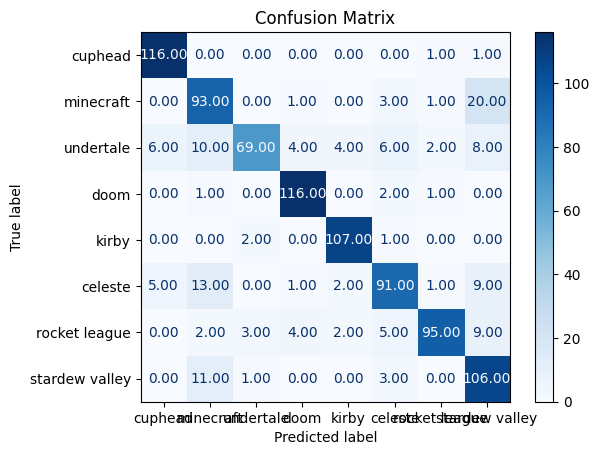

In [83]:
cm = confusion_matrix(y_true, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm,display_labels=labels)

# Plot the confusion matrix
plt.figure(figsize=(8, 8))
disp.plot(cmap=plt.cm.Blues, values_format=".2f")
plt.title("Confusion Matrix")
plt.show()

In [64]:
print(id2label)

{0: 'cuphead', 1: 'minecraft', 2: 'undertale', 3: 'doom', 4: 'kirby', 5: 'celeste', 6: 'rocket league', 7: 'stardew valley'}


In [90]:
for i in range(len(dataset)):
    if y_true[i]==2 and y_pred[i]==5:
        print(i)

879
880
915
930
931
932


In [96]:
dataset['file'][915]

WindowsPath('30 sec train/undertale/undertalesong_num_149,sample_2.wav')

In [ ]:
Audio(dataset['file'][915])